In [1]:
import re
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision import datasets
from PIL import Image

import os
from os import listdir
from os.path import isfile, join
import string
import matplotlib.pyplot as plt
from load_data import load_images

from skimage.feature import local_binary_pattern, hog

train_images, train_labels, test_images, test_labels = load_images('ufi-cropped')

train_images.shape, test_images.shape

train_raw, test_raw = np.copy(train_images), np.copy(test_images)
train_raw.shape, test_raw.shape

train_hog, test_hog = np.copy(train_images), np.copy(test_images)
for i in range(train_images.shape[0]):
    _, train_hog[i] = hog(train_hog[i], orientations=4, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualize=True)

for i in range(test_images.shape[0]):
    _, test_hog[i] = hog(train_hog[i], orientations=4, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualize=True)
    
train_hog.shape, test_hog.shape

train_lbp, test_lbp = np.copy(train_images), np.copy(test_images)
for i in range(train_images.shape[0]):
    train_lbp[i] = local_binary_pattern(train_lbp[0], P=8, R=2, method="uniform")

for i in range(test_images.shape[0]):
    test_hog[i] = local_binary_pattern(test_lbp[0], P=8, R=2, method="uniform")
    
train_hog.shape, test_hog.shape

plt.imshow(train_raw[0], cmap=plt.cm.gray)

lbp=local_binary_pattern(train_images[0], P=8, R=2, method="uniform")
lbp

_, hog_img = hog(train_images[0], orientations=4, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualize=True)

plt.imshow(train_hog[0], cmap=plt.cm.gray)

plt.imshow(train_lbp[0], cmap=plt.cm.gray)

train_images_plus = np.zeros((train_images.shape[0], train_images.shape[1], train_images.shape[2], 3))
for i in range(train_images.shape[0]):
    train_images_plus[i] = np.dstack((train_raw[i], train_hog[i], train_lbp[i]))
train_images_plus.shape

test_images_plus = np.zeros((test_images.shape[0], test_images.shape[1], test_images.shape[2], 3))
for i in range(test_images.shape[0]):
    test_images_plus[i] = np.dstack((test_raw[i], test_hog[i], test_lbp[i]))
test_images_plus.shape

train_images = train_images.reshape(-1, 1, 128, 128)
test_images = test_images.reshape(-1, 1, 128, 128)

train_images.shape, test_images.shape

class UFIDataset(torch.utils.data.Dataset):
    def __init__(self, images, labels):
        self.images = images
        self.labels = labels
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, index):
        img = self.images[index]
        image = torch.from_numpy(img).float()
        label = self.labels[index]
        
        return image, label

In [2]:
train_data = datasets.ImageFolder('ufi-cropped/train', transform=transforms.ToTensor())
test_data = datasets.ImageFolder('ufi-cropped/test', transform=transforms.ToTensor())

ufi_train_data = UFIDataset(train_images, train_labels)
ufi_test_data = UFIDataset(test_images, test_labels)

train_loader = torch.utils.data.DataLoader(dataset=ufi_train_data,
                                         batch_size=32,
                                         shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=ufi_test_data,
                                         batch_size=32)

In [3]:
train_loader = torch.utils.data.DataLoader(dataset=train_data,
                                         batch_size=32,
                                         shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_data,
                                         batch_size=32)

In [4]:
#sample batch check
data_iter = iter(train_loader)
X, Y = data_iter.next()

X.size(), Y.size()

(torch.Size([32, 3, 128, 128]), torch.Size([32]))

In [5]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
use_cuda = True

In [6]:
os.environ['TORCH_MODEL_ZOO'] = 'E:\\College\\Final Year Project\\ufi\\models'
model_pre = torchvision.models.resnet50(pretrained=True)

In [7]:
from collections import OrderedDict


classifier = nn.Sequential(OrderedDict([
                          ('fc1', nn.Linear(8192, 2048)),
                          ('relu1', nn.ReLU()),
                          ('dropout1', nn.Dropout(0.5)),
                          ('fc2', nn.Linear(2048, 1024)),
                          ('relu2', nn.ReLU()),
                          ('dropout2', nn.Dropout(0.5)),
                          ('output', nn.Linear(1024, 605))
                          ])) 
model_pre.avgpool = nn.AvgPool2d(kernel_size=3, stride=1, padding=0)
model_pre.fc = classifier

model = model_pre #nn.Sequential(nn.Conv2d(1, 3, kernel_size=3, padding=1), model_pre)

In [8]:
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [9]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

In [10]:
losses = {'train':[], 'validation':[]}

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
            optimizer.zero_grad()
            
            pred = model(data)
            loss = criterion(pred, target)
            
            train_loss += ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
            loss.backward()
            optimizer.step()
    
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['test']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            
            val_pred = model(data)
            val_loss = criterion(val_pred, target)
            
            valid_loss += ((1 / (batch_idx + 1)) * (val_loss.data - valid_loss))
            
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
    
        ## TODO: save the model if validation loss has decreased
        if (valid_loss < valid_loss_min):
            print("Saving model.  Validation loss:... {} --> {}".format(valid_loss_min, valid_loss.item()))
            valid_loss_min = valid_loss
            torch.save(model.state_dict(), save_path)
            print()
            
        losses['train'].append(train_loss)
        losses['validation'].append(valid_loss)
        
    # return trained model
    return model

# defining dataloaders as dictionary
loaders_scratch = {'train': train_loader, 'test': test_loader}

# train the model
model = train(50, loaders_scratch, model, optimizer, 
                      criterion, use_cuda, 'model.pt')

# load the model that got the best validation accuracy
#model_scratch.load_state_dict(torch.load('model.pt'))

Epoch: 1 	Training Loss: 6.436089 	Validation Loss: 6.376951
Saving model.  Validation loss:... inf --> 6.376951217651367

Epoch: 2 	Training Loss: 6.318959 	Validation Loss: 6.258171
Saving model.  Validation loss:... 6.376951217651367 --> 6.2581706047058105

Epoch: 3 	Training Loss: 6.148512 	Validation Loss: 6.098238
Saving model.  Validation loss:... 6.2581706047058105 --> 6.098237991333008

Epoch: 4 	Training Loss: 5.921378 	Validation Loss: 5.897824
Saving model.  Validation loss:... 6.098237991333008 --> 5.897823810577393

Epoch: 5 	Training Loss: 5.610999 	Validation Loss: 5.597573
Saving model.  Validation loss:... 5.897823810577393 --> 5.597573280334473

Epoch: 6 	Training Loss: 5.166977 	Validation Loss: 5.257333
Saving model.  Validation loss:... 5.597573280334473 --> 5.257333278656006

Epoch: 7 	Training Loss: 4.730684 	Validation Loss: 4.793831
Saving model.  Validation loss:... 5.257333278656006 --> 4.793830871582031

Epoch: 8 	Training Loss: 4.307362 	Validation Loss: 4

In [11]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.00005)

In [12]:
model = train(50, loaders_scratch, model, optimizer, 
                      criterion, use_cuda, 'model.pt')

Epoch: 1 	Training Loss: 0.126740 	Validation Loss: 2.429352
Saving model.  Validation loss:... inf --> 2.429352045059204

Epoch: 2 	Training Loss: 0.094869 	Validation Loss: 2.409996
Saving model.  Validation loss:... 2.429352045059204 --> 2.4099960327148438

Epoch: 3 	Training Loss: 0.094362 	Validation Loss: 2.346881
Saving model.  Validation loss:... 2.4099960327148438 --> 2.34688138961792

Epoch: 4 	Training Loss: 0.071103 	Validation Loss: 2.319645
Saving model.  Validation loss:... 2.34688138961792 --> 2.3196449279785156

Epoch: 5 	Training Loss: 0.063158 	Validation Loss: 2.311215
Saving model.  Validation loss:... 2.3196449279785156 --> 2.3112149238586426

Epoch: 6 	Training Loss: 0.077331 	Validation Loss: 2.335981
Epoch: 7 	Training Loss: 0.077257 	Validation Loss: 2.321638
Epoch: 8 	Training Loss: 0.057567 	Validation Loss: 2.384036
Epoch: 9 	Training Loss: 0.072231 	Validation Loss: 2.424951
Epoch: 10 	Training Loss: 0.068367 	Validation Loss: 2.452878
Epoch: 11 	Training 

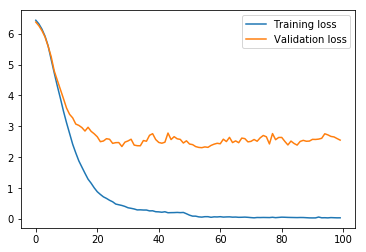

In [13]:
import matplotlib.pyplot as plt
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()

In [14]:
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in train_loader:
        images, labels = images.cuda(), labels.cuda()
        
        pred = model(images)
        
        predictions = torch.argmax(pred, 1)
        
        correct += (predictions == labels).sum().item()
        
    total = len(train_data)

In [15]:
print('training-accuracy:', (correct/total)*100)

training-accuracy: 99.95366079703429


In [16]:
# testing the model
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images, labels = images.cuda(), labels.cuda()
        
        pred = model(images)
        
        predictions = torch.argmax(pred, 1)
        
        correct += (predictions == labels).sum().item()
        
    total = len(test_data)

In [17]:
print('testing-accuracy:', (correct/total)*100)

testing-accuracy: 63.47107438016529


In [21]:
def predict(img_path):
    # load the image and return the predicted breed
    img = Image.open(img_path).convert('RGB')

    transform = transforms.ToTensor()
    img_tensor = transform(img)

    # reshaping to include batch size
    img_tensor = img_tensor.view(1, img_tensor.shape[0], img_tensor.shape[1], img_tensor.shape[2])

    prediction = model(img_tensor.cuda())
    class_idx = torch.argmax(prediction, 1)
    
    return train_data.classes[class_idx]

In [22]:
class_names = os.listdir('ufi-cropped/test')

test_filenames = []
for class_name in class_names:
    test_filenames.append(os.path.join('ufi-cropped/test/'+ class_name + '/', os.listdir('ufi-cropped/test/'+ class_name)[0]))

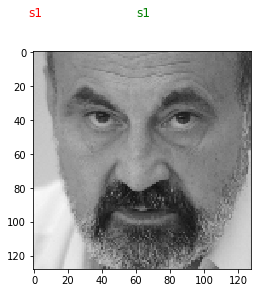

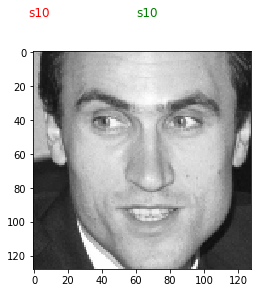

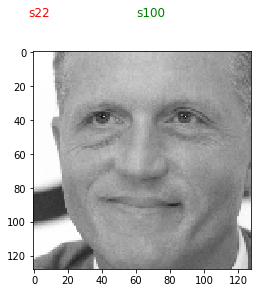

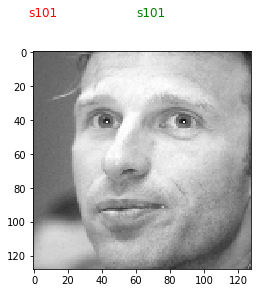

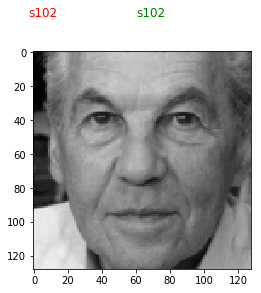

...

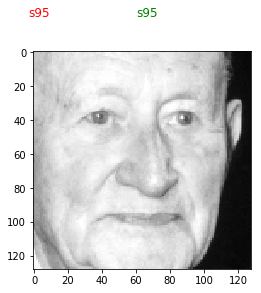

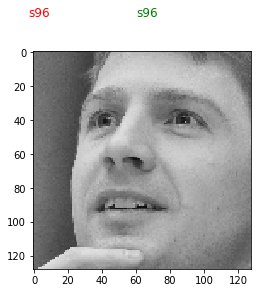

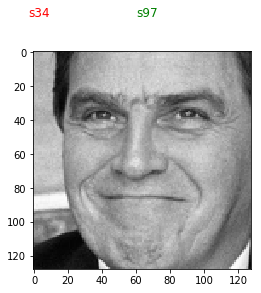

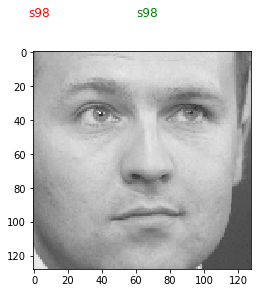

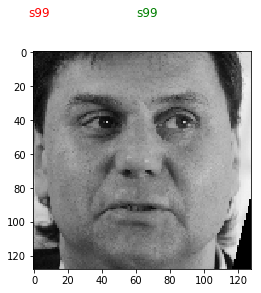

In [24]:
for label, path in zip(class_names, test_filenames):    
    pred = predict(path)
    plt.imshow(Image.open(path), cmap=plt.cm.gray)
    plt.gcf().text(0.25, 1, pred, fontsize=12, color='red')
    plt.gcf().text(0.5, 1, label, fontsize=12, color='green')
    plt.show()